In [ ]:
!git clone https://github.com/CompVis/latent-diffusion.git
!git clone https://github.com/CompVis/taming-transformers
!pip install -e ./taming-transformers
!pip install ipywidgets omegaconf>=2.0.0 pytorch-lightning>=1.0.8 torch-fidelity einops

import sys
!sed -i 's/from torch._six import string_classes/from collections.abc import Iterable/' ./taming-transformers/taming/data/utils.py
sys.path.append(".")
sys.path.append('./taming-transformers')
from taming.models import vqgan # checking correct import from taming

Cloning into 'latent-diffusion'...
remote: Enumerating objects: 341, done.
remote: Counting objects: 100% (157/157), done.
remote: Compressing objects: 100% (47/47), done.
remote: Total 341 (delta 115), reused 110 (delta 110), pack-reused 184 (from 1)
Receiving objects: 100% (341/341), 28.69 MiB | 23.41 MiB/s, done.
Resolving deltas: 100% (148/148), done.
Cloning into 'taming-transformers'...
remote: Enumerating objects: 1342, done.
remote: Counting objects: 100% (2/2), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 1342 (delta 0), reused 1 (delta 0), pack-reused 1340 (from 1)
Receiving objects: 100% (1342/1342), 409.77 MiB | 31.13 MiB/s, done.
Resolving deltas: 100% (282/282), done.
Obtaining file:///content/taming-transformers
  Preparing metadata (setup.py) ... done
  Running setup.py develop for taming-transformers


In [ ]:
%cd latent-diffusion
import ipywidgets as widgets
from IPython.display import display

mode = widgets.Select(options=['superresolution'],
    value='superresolution', description='Task:')
display(mode)

/content/latent-diffusion


Select(description='Task:', options=('superresolution',), value='superresolution')

In [ ]:
from notebook_helpers import get_model
!sed -i 's/from pytorch_lightning.utilities.distributed import rank_zero_only/from pytorch_lightning.utilities.rank_zero import rank_zero_only/' /content/latent-diffusion/ldm/models/diffusion/ddpm.py
model = get_model(mode.value)

Using downloaded and verified file: logs/diffusion/superresolution_bsr/configs/project.yaml/?dl=1
Using downloaded and verified file: logs/diffusion/superresolution_bsr/checkpoints/last.ckpt/?dl=1
Loading model from logs/diffusion/superresolution_bsr/checkpoints/last.ckpt/?dl=1
LatentDiffusion: Running in eps-prediction mode
DiffusionWrapper has 113.62 M params.
Keeping EMAs of 308.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 3, 64, 64) = 12288 dimensions.
making attention of type 'vanilla' with 512 in_channels


In [ ]:
from notebook_helpers import get_custom_cond
get_custom_cond(mode.value)

Saving to_super.png to to_super.png


In [ ]:
from notebook_helpers import get_cond_options, get_cond
dir, options = get_cond_options(mode.value)
cond_choice = widgets.RadioButtons(
        options=options,
        description='Select conditioning:',
        disabled=False
    )
display(cond_choice)

RadioButtons(description='Select conditioning:', options=('custom_to_super.png', 'sample_0.jpg'), value='custo…

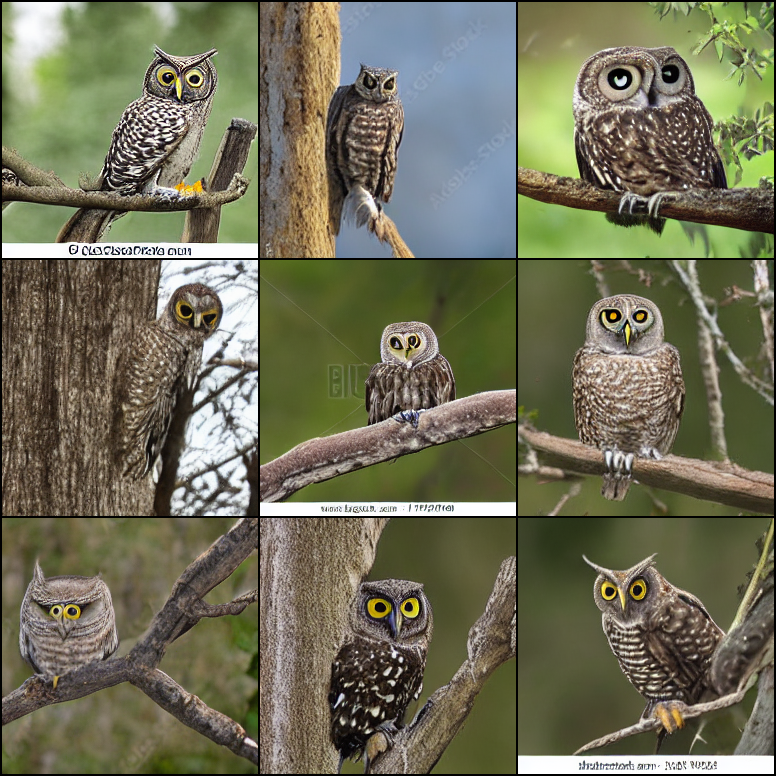

Plotting: Switched to EMA weights
Sampling with eta = 1.0; steps: 100
Data shape for DDIM sampling is (1, 3, 776, 776), eta 1.0
Running DDIM Sampling with 100 timesteps


DDIM Sampler: 100%|██████████| 100/100 [14:09<00:00,  8.50s/it]


Plotting: Restored training weights


In [ ]:
from notebook_helpers import run
import os
custom_steps = 100
cond_choice_path = os.path.join(dir, cond_choice.value)
logs = run(model["model"], cond_choice_path, mode.value, custom_steps)

<ipython-input-9-ce0698a45d57>:10: RuntimeWarning: invalid value encountered in cast
  sample = sample.numpy().astype(np.uint8)


(1, 3104, 3104, 3)


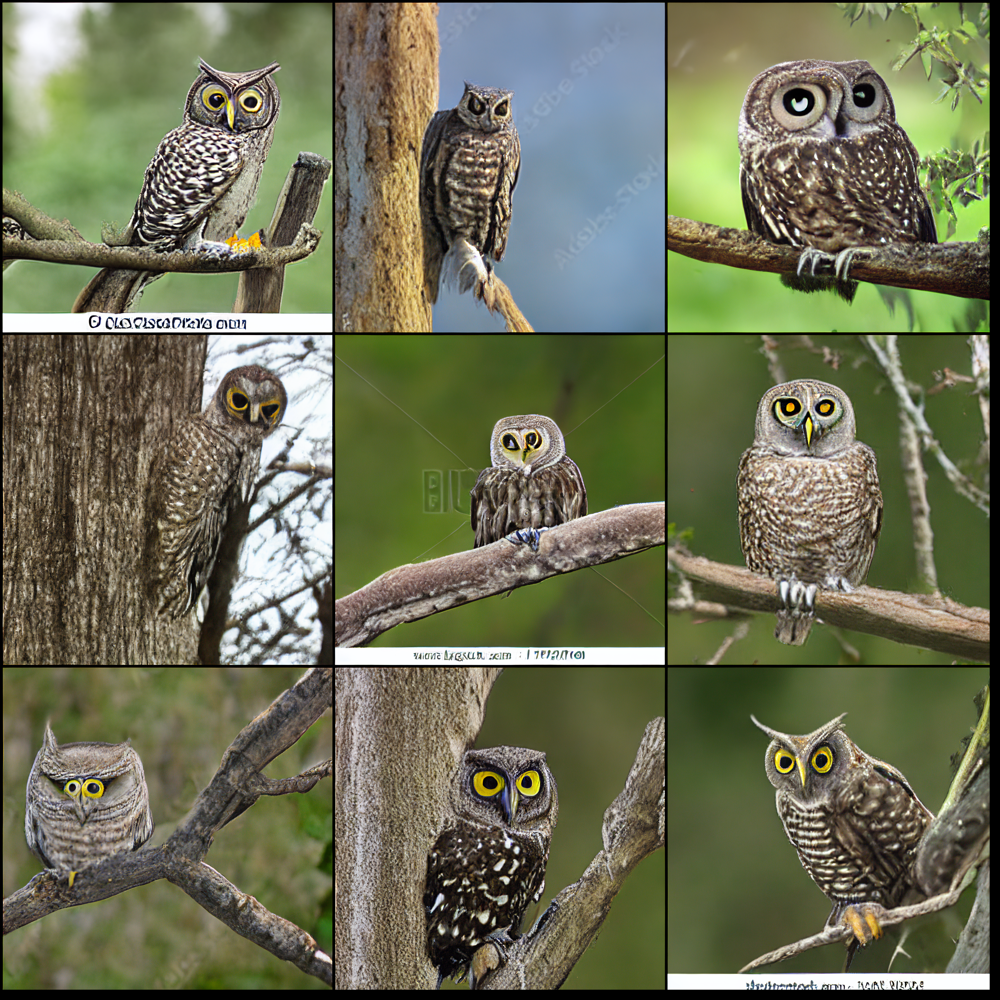

In [ ]:
import torch
import numpy as np
import IPython.display as d
from PIL import Image

sample = logs["sample"]
sample = sample.detach().cpu()
sample = torch.clamp(sample, -1., 1.)
sample = (sample + 1.) / 2. * 255
sample = sample.numpy().astype(np.uint8)
sample = np.transpose(sample, (0, 2, 3, 1))
print(sample.shape)
a = Image.fromarray(sample[0])
display(a)
